<h1>Table of Contents<span class="tocSkip"></span></h1>

<div class="toc"><ul class="toc-item"><li><span><a href="#Initialization-and-preprocessing" data-toc-modified-id="Initialization-and-preprocessing-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Initialization and preprocessing</a></span></li>

<li><span><a href="#Term-Frequency-(TF)" data-toc-modified-id="Term-Frequency-(TF)-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Term Frequency (TF)</a></span></li>

<li><span><a href="#Inverse-Document-Frequency-(IDF)" data-toc-modified-id="Inverse-Document-Frequency-(IDF)-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Inverse Document Frequency (IDF)</a></span></li>

<li><span><a href="#Compute-TFIDF" data-toc-modified-id="Compute-TFIDF-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Compute TFIDF</a></span></li>

<li><span><a href="#Convert-to-sparse-matrix" data-toc-modified-id="Convert-to-sparse-matrix-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Convert to sparse matrix</a></span></li>

<li><span><a href="#Compare-our-matrix-with-Python-implementation" data-toc-modified-id="Compare-our-matrix-with-Python-implementation-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Compare our matrix with Python implementation</a></span></li>

<li><span><a href="#Build-a-bar-chart" data-toc-modified-id="Build-a-bar-chart"><span class="toc-item-num">7&nbsp;&nbsp;</span>Build a bar chart</a></span></li>

<li><span><a href="#Build-a-word-cloud" data-toc-modified-id="Build-a-word-cloud"><span class="toc-item-num">8&nbsp;&nbsp;</span>Build a word cloud</a></span></li></ul></div>

# TF/IDF from scratch

## Initialization and preprocessing
Let's take two sentences as an example

In [1]:
import pandas as pd
%matplotlib inline 

In [156]:
#Here you can also get a subset of your own dataset of comments
docA='I went skiing with my friends last weekend'
docB='My friends and I play poker every weekend'
doc= pd.read_csv('crpytodata_test_post_lda.csv')
doc = doc.stopword_reviews

Now, we tokenize all words of our corpus to build a dictionary and get rid of stopwords and punctuation

In [122]:
from nltk import word_tokenize
from string import punctuation
from nltk.corpus import stopwords

stopW = stopwords.words('english') + list(punctuation)

In [123]:
#import nltk #execute only if necesseray
#nltk.download('punkt') #execute only if necesseray

In [124]:
bag_of_words = [word_tokenize(text.lower()) for text in doc]

In [125]:
bag_of_words

[['[',
  "'coinspeakerprobit",
  "'",
  ',',
  "'professional",
  "'",
  ',',
  "'digital",
  "'",
  ',',
  "'currency",
  "'",
  ',',
  "'exchange",
  "'",
  ',',
  "'holding",
  "'",
  ',',
  "'something",
  "'",
  ',',
  "'store",
  "'",
  ',',
  "'everyoneprobit",
  "'",
  ',',
  "'exchange",
  "'",
  ',',
  "'seeks",
  "'",
  ',',
  "'provide",
  "'",
  ',',
  "'secure",
  "'",
  ',',
  "'digital",
  "'",
  ',',
  "'assets",
  "'",
  ',',
  "'marketplace",
  "'",
  ',',
  "'traders",
  "'",
  ',',
  "'different",
  "'",
  ',',
  "'skills",
  "'",
  ',',
  "'experience",
  "'",
  ',',
  "'ways",
  "'",
  ',',
  "'providing",
  "'",
  ',',
  "'customizable",
  "'",
  ',',
  "'user",
  "'",
  ',',
  "'interface",
  "'",
  ',',
  "'users",
  "'",
  ',',
  "'modify",
  "'",
  ',',
  "'way",
  "'",
  ',',
  "'view",
  "'",
  ',',
  "'trades",
  "'",
  ',',
  "'probit",
  "'",
  ',',
  "'professional",
  "'",
  ',',
  "'digital",
  "'",
  ',',
  "'currency",
  "'",
  ',',
  "'exchange",


In [126]:
for i, sent in enumerate(bag_of_words):
    bag_of_words[i] = [w for w in bag_of_words[i] if w not in stopW]

In [127]:
bag_of_words

[["'coinspeakerprobit",
  "'professional",
  "'digital",
  "'currency",
  "'exchange",
  "'holding",
  "'something",
  "'store",
  "'everyoneprobit",
  "'exchange",
  "'seeks",
  "'provide",
  "'secure",
  "'digital",
  "'assets",
  "'marketplace",
  "'traders",
  "'different",
  "'skills",
  "'experience",
  "'ways",
  "'providing",
  "'customizable",
  "'user",
  "'interface",
  "'users",
  "'modify",
  "'way",
  "'view",
  "'trades",
  "'probit",
  "'professional",
  "'digital",
  "'currency",
  "'exchange",
  "'holding",
  "'something",
  "'store",
  "'everyone"],
 ["'today",
  "'crypto",
  "'heard",
  "'rumors",
  "'satoshi",
  "'return",
  "'saw",
  "'capitulation",
  "'talk",
  "'bitcoin",
  "'etf",
  "'pitches",
  "'appeals",
  "'intel",
  "'patent",
  "'bitcoin",
  "'mining",
  "'negativity",
  "'mainstream",
  "'influencers",
  "'post",
  "'daily",
  "'crypto",
  "'roundup",
  "'11",
  "'30",
  "'2018",
  "'appeared",
  "'first",
  "'crypto",
  "'insider"],
 ["'crashes",
  "'

Get all unique words of the corpus

In [128]:
wordSet = set().union(*bag_of_words)
wordSet

{"'led",
 "'trail",
 "'mode",
 "'thanksgiving",
 "'said",
 "'positive",
 "'involved",
 "'labs",
 "'killer",
 "'luxury",
 "'fans",
 "'especially",
 "'startups",
 "'r3",
 "'missed",
 "'investors",
 "'78",
 "'filing",
 "'12",
 "'discovery",
 "'bent",
 "'intervening",
 "'shelters",
 "'frequency",
 "'stormed",
 "'ventures",
 "'life",
 "'circa",
 "'citizens",
 "'mexico",
 "'everybodys",
 "'enables",
 "'spectacular",
 "'kucoin",
 "'suspect",
 "'tapthere",
 "'matching",
 "'4350",
 "'moser",
 "'30december",
 "'hardline",
 "'six",
 "'told",
 "'massive",
 "'33",
 "'activity",
 "'clearly",
 "'stepping",
 "'directly",
 "'involvement",
 "'degree",
 "'unequivocally",
 "'distinguished",
 "'irisiumis",
 "'patterns",
 "'leaving",
 "'24",
 "'cryptojacking",
 "'powell",
 '0',
 "'tough",
 "'creek",
 "'contradiction",
 "'receives",
 "'conditions",
 "'africa",
 "'net",
 "'extended",
 "'dozens",
 "'disappointed",
 "'bubble",
 "'chance",
 "'later",
 "'loophole",
 "'association",
 "'korean",
 "'202",
 "'laws",


Now, we create a list with one dictionary for each review, containing all words of the corpus

In [129]:
wordDict = []

for i in range(len(bag_of_words)):
    wordDict.append(dict.fromkeys(wordSet, 0))

In [130]:
wordDict

[{"'led": 0,
  "'trail": 0,
  "'mode": 0,
  "'thanksgiving": 0,
  "'said": 0,
  "'positive": 0,
  "'involved": 0,
  "'labs": 0,
  "'killer": 0,
  "'luxury": 0,
  "'fans": 0,
  "'especially": 0,
  "'startups": 0,
  "'r3": 0,
  "'missed": 0,
  "'investors": 0,
  "'78": 0,
  "'filing": 0,
  "'12": 0,
  "'discovery": 0,
  "'bent": 0,
  "'intervening": 0,
  "'shelters": 0,
  "'frequency": 0,
  "'stormed": 0,
  "'ventures": 0,
  "'life": 0,
  "'circa": 0,
  "'citizens": 0,
  "'mexico": 0,
  "'everybodys": 0,
  "'enables": 0,
  "'spectacular": 0,
  "'kucoin": 0,
  "'suspect": 0,
  "'tapthere": 0,
  "'matching": 0,
  "'4350": 0,
  "'moser": 0,
  "'30december": 0,
  "'hardline": 0,
  "'six": 0,
  "'told": 0,
  "'massive": 0,
  "'33": 0,
  "'activity": 0,
  "'clearly": 0,
  "'stepping": 0,
  "'directly": 0,
  "'involvement": 0,
  "'degree": 0,
  "'unequivocally": 0,
  "'distinguished": 0,
  "'irisiumis": 0,
  "'patterns": 0,
  "'leaving": 0,
  "'24": 0,
  "'cryptojacking": 0,
  "'powell": 0,
  '

If a review countains a word, we're adding 1 to its count

In [131]:
for i, sent in enumerate(bag_of_words): 
    for word in sent:
        wordDict[i][word]+=1

In [132]:
wordDict

[{"'led": 0,
  "'trail": 0,
  "'mode": 0,
  "'thanksgiving": 0,
  "'said": 0,
  "'positive": 0,
  "'involved": 0,
  "'labs": 0,
  "'killer": 0,
  "'luxury": 0,
  "'fans": 0,
  "'especially": 0,
  "'startups": 0,
  "'r3": 0,
  "'missed": 0,
  "'investors": 0,
  "'78": 0,
  "'filing": 0,
  "'12": 0,
  "'discovery": 0,
  "'bent": 0,
  "'intervening": 0,
  "'shelters": 0,
  "'frequency": 0,
  "'stormed": 0,
  "'ventures": 0,
  "'life": 0,
  "'circa": 0,
  "'citizens": 0,
  "'mexico": 0,
  "'everybodys": 0,
  "'enables": 0,
  "'spectacular": 0,
  "'kucoin": 0,
  "'suspect": 0,
  "'tapthere": 0,
  "'matching": 0,
  "'4350": 0,
  "'moser": 0,
  "'30december": 0,
  "'hardline": 0,
  "'six": 0,
  "'told": 0,
  "'massive": 0,
  "'33": 0,
  "'activity": 0,
  "'clearly": 0,
  "'stepping": 0,
  "'directly": 0,
  "'involvement": 0,
  "'degree": 0,
  "'unequivocally": 0,
  "'distinguished": 0,
  "'irisiumis": 0,
  "'patterns": 0,
  "'leaving": 0,
  "'24": 0,
  "'cryptojacking": 0,
  "'powell": 0,
  '

We have our Document Term Matrix

In [133]:
df = pd.DataFrame(wordDict)
df.head()

,'***,'+,'00,'000,'000+,'000012,'000s,'0022,'00228,'0144,...,9,``,b,e,j,k,p,q,u,w
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


We build a bar plot

In [134]:
df_mean = df.mean().sort_values(ascending=False).to_frame(name='occurence mean')

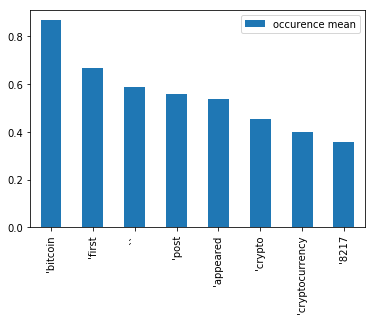

In [135]:
df_mean[:8].plot.bar()

## Term Frequency (TF)

Here instead of using a raw count, let's try a term frequency adjusted for document length

In [136]:
def compute_TF(wordDict, bow):
    tfDict = {}
    bowCount = len(bow)
    for word, count in wordDict.items():
        tfDict[word] = count/float(bowCount)
    return tfDict

In [137]:
tfBow = []
for i in range(len(bag_of_words)):
    tfBow.append(compute_TF(wordDict[i], bag_of_words[i]))

In [138]:
tfBow

[{"'led": 0.0,
  "'trail": 0.0,
  "'mode": 0.0,
  "'thanksgiving": 0.0,
  "'said": 0.0,
  "'positive": 0.0,
  "'involved": 0.0,
  "'labs": 0.0,
  "'killer": 0.0,
  "'luxury": 0.0,
  "'fans": 0.0,
  "'especially": 0.0,
  "'startups": 0.0,
  "'r3": 0.0,
  "'missed": 0.0,
  "'investors": 0.0,
  "'78": 0.0,
  "'filing": 0.0,
  "'12": 0.0,
  "'discovery": 0.0,
  "'bent": 0.0,
  "'intervening": 0.0,
  "'shelters": 0.0,
  "'frequency": 0.0,
  "'stormed": 0.0,
  "'ventures": 0.0,
  "'life": 0.0,
  "'circa": 0.0,
  "'citizens": 0.0,
  "'mexico": 0.0,
  "'everybodys": 0.0,
  "'enables": 0.0,
  "'spectacular": 0.0,
  "'kucoin": 0.0,
  "'suspect": 0.0,
  "'tapthere": 0.0,
  "'matching": 0.0,
  "'4350": 0.0,
  "'moser": 0.0,
  "'30december": 0.0,
  "'hardline": 0.0,
  "'six": 0.0,
  "'told": 0.0,
  "'massive": 0.0,
  "'33": 0.0,
  "'activity": 0.0,
  "'clearly": 0.0,
  "'stepping": 0.0,
  "'directly": 0.0,
  "'involvement": 0.0,
  "'degree": 0.0,
  "'unequivocally": 0.0,
  "'distinguished": 0.0,
  

## Inverse Document Frequency (IDF)

In [139]:
import math
def compute_IDF(wordDict):
    idfDict = {}
    N = len(wordDict)
    idfDict = dict.fromkeys(wordDict[0].keys(), 0)
    for doc in wordDict:
        for word, val in doc.items():
            if val > 0:
                idfDict[word] += 1 #if the word is in the document
    for word, val in idfDict.items():
        idfDict[word] = math.log10(N / float(val))
    return idfDict

In [140]:
idfs = compute_IDF(wordDict)

In [141]:
idfs

{"'led": 1.7958800173440752,
 "'trail": 2.6989700043360187,
 "'mode": 2.6989700043360187,
 "'thanksgiving": 2.6989700043360187,
 "'said": 1.3187587626244128,
 "'positive": 1.585026652029182,
 "'involved": 2.221848749616356,
 "'labs": 1.6575773191777938,
 "'killer": 2.6989700043360187,
 "'luxury": 2.221848749616356,
 "'fans": 2.3979400086720375,
 "'especially": 2.221848749616356,
 "'startups": 2.6989700043360187,
 "'r3": 2.6989700043360187,
 "'missed": 2.6989700043360187,
 "'investors": 1.1307682802690238,
 "'78": 2.3979400086720375,
 "'filing": 2.6989700043360187,
 "'12": 1.6989700043360187,
 "'discovery": 2.6989700043360187,
 "'bent": 2.6989700043360187,
 "'intervening": 2.6989700043360187,
 "'shelters": 2.6989700043360187,
 "'frequency": 2.3979400086720375,
 "'stormed": 2.6989700043360187,
 "'ventures": 2.221848749616356,
 "'life": 2.3979400086720375,
 "'circa": 2.6989700043360187,
 "'citizens": 2.3979400086720375,
 "'mexico": 2.6989700043360187,
 "'everybodys": 2.6989700043360187,
 

## Compute TFIDF

In [142]:
def compute_TFIDF(tfBow, idfs):
    tfidf = {}
    for word, val in tfBow.items():
        tfidf[word] = val*idfs[word]
    return tfidf

In [143]:
tfidf = []
for i in range(len(tfBow)):
    tfidf.append(compute_TFIDF(tfBow[i], idfs))

In [144]:
tfidf = pd.DataFrame(tfidf)
tfidf.head()

,'***,'+,'00,'000,'000+,'000012,'000s,'0022,'00228,'0144,...,9,``,b,e,j,k,p,q,u,w
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [145]:
print('A few words with lowest tfidf\n\n',tfidf.apply(sum).sort_values()[:5])
print('\n\nWords with largest tfidf\n\n',tfidf.apply(sum).sort_values()[-5:])

A few words with lowest tfidf

 'topping      0.018114
'encounter    0.018114
'82           0.018114
'properly     0.018114
'levelthe     0.018114
dtype: float64


Words with largest tfidf

 'cryptocurrency    2.702003
'blockchain        3.425725
'crypto            3.479440
'bitcoin           3.629000
``                 3.712123
dtype: float64


## Compare our matrix with Python implementation

In [146]:
#Here you can also get a subset of your own dataset of comments
docA='I went skiing with my friends last weekend'
docB='My friends and I play poker every weekend'


In [157]:
from string import punctuation
from nltk.corpus import stopwords

stopW = stopwords.words('english') + list(punctuation)
more_stopwords=['n\'t','...','\'ve','\'re', 'ã\x9dou', "''" ]

In [158]:
from sklearn.feature_extraction.text import TfidfVectorizer
from nltk import word_tokenize

vect = TfidfVectorizer(tokenizer=word_tokenize,stop_words=stopW+more_stopwords)
vect_transformed = vect.fit_transform(doc)

In [159]:
import numpy as np
feature_names = np.array(vect.get_feature_names())
sorted_tfidf_index = vect_transformed.max(0).toarray()[0].argsort()

print('Smallest tfidf:\n{}\n'.format(feature_names[sorted_tfidf_index[:10]]))
print('Largest tfidf: \n{}'.format(feature_names[sorted_tfidf_index[:-11:-1]]))

Smallest tfidf:
["'topping" "'levelfigure" "'levelthe" "'500s" "'devaluation" "'properly"
 "'worrying" "'retested" "'relevance" "'indecisive"]

Largest tfidf: 
["'nan" "'quot" "'gmb" "'nullex" "'|" "'cryptopia" "'huobi" "'betting"
 "'microsoft" "'winners"]


In [160]:
df_sklearn = pd.DataFrame(vect_transformed.todense(), columns = feature_names)
df_sklearn.head()

,'***,'+,'00,'000,'000+,'000012,'000s,'0022,'00228,'0144,...,9,``,b,e,j,k,p,q,u,w
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


They have similar values. Not exactly the same because the formulas used to comput the TF-IDF scores are different.

## Build a bar chart

In [161]:
df_sklearn_mean = df_sklearn.mean().sort_values(ascending=False).to_frame(name='tfidf mean')
df_sklearn_mean.head()

,tfidf mean
'bitcoin,0.043307
``,0.037663
'crypto,0.030453
'first,0.027568
'blockchain,0.025248


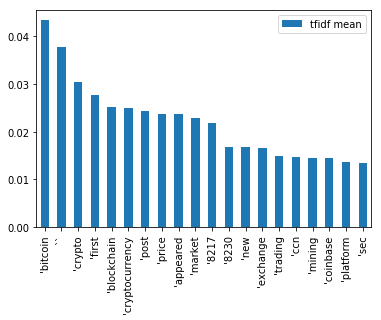

In [162]:
df_sklearn_mean[:20].plot.bar()

## Build a word cloud

In [163]:
from wordcloud import WordCloud
from PIL import Image
import matplotlib.pyplot as plt

In [164]:
dict_words_tfidf = df_sklearn_mean[df_sklearn_mean['tfidf mean'] != 0].to_dict()['tfidf mean']

In [165]:
#read mask (just for fun)
hotel_mask = np.array(Image.open("hotel.jpg"))

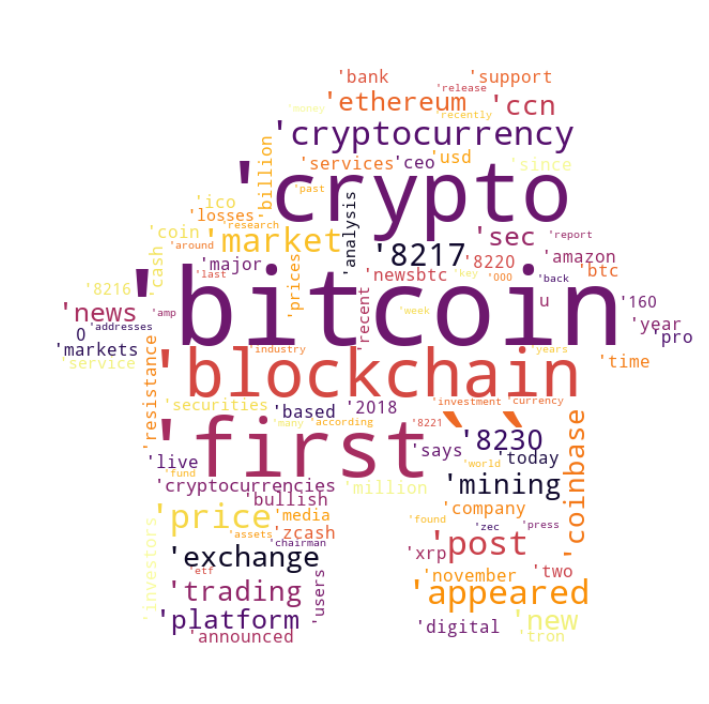

In [166]:
wordcloud = WordCloud(height=600, width=800, background_color="white", colormap='inferno', max_words=100, mask=hotel_mask)
wordcloud.generate_from_frequencies(frequencies=dict_words_tfidf)
plt.figure(figsize=(12,16))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

**Now it's your turn! Use your own datasets to get key insights about the main topics discussed in the reviews**